In [21]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Load the data
file_path = 'csv\m1.csv'
data = pd.read_csv(file_path, header=None, skiprows=1, names=['x', 'y', 'polarity', 'timestamp'])

# Convert timestamp from microseconds to seconds
data['timestamp'] = data['timestamp'] / 1e6

# Display basic statistics and the first few rows to ensure proper loading and conversion
data.describe(), data.head()


<>:6: SyntaxWarning: invalid escape sequence '\m'
<>:6: SyntaxWarning: invalid escape sequence '\m'
C:\Users\rriano\AppData\Local\Temp\ipykernel_36896\62678280.py:6: SyntaxWarning: invalid escape sequence '\m'
  file_path = 'csv\m1.csv'
C:\Users\rriano\AppData\Local\Temp\ipykernel_36896\62678280.py:6: SyntaxWarning: invalid escape sequence '\m'
  file_path = 'csv\m1.csv'


FileNotFoundError: [Errno 2] No such file or directory: 'csv\\m1.csv'

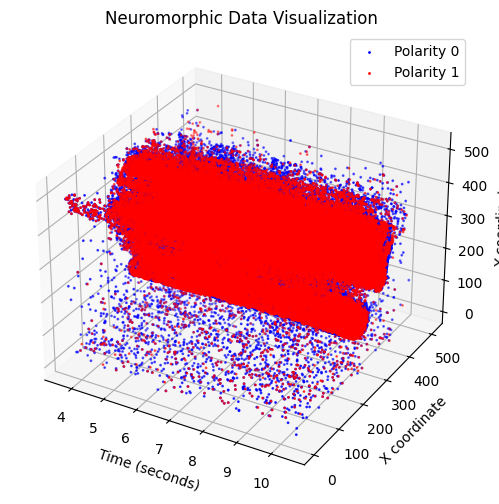

In [6]:
# Creating the 3D scatter plot
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(111, projection='3d')

# Scatter plot using different colors for different polarities
colors = {0: 'blue', 1: 'red'}  # Define color for each polarity
for polarity, group in data.groupby('polarity'):
    ax.scatter(group['timestamp'], group['x'], group['y'], c=colors[polarity], label=f'Polarity {polarity}', s=1)

# Setting labels
ax.set_xlabel('Time (seconds)')
ax.set_ylabel('X coordinate')
ax.set_zlabel('Y coordinate')
ax.set_title('Neuromorphic Data Visualization')
ax.legend()

# Show plot
plt.show()

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from ipywidgets import interact, interactive, fixed
from IPython.display import display

# Load the data
file_path = 'csv\m1.csv'
data = pd.read_csv(file_path, header=None, skiprows=1, names=['x', 'y', 'polarity', 'timestamp'])

# Convert timestamp from microseconds to seconds
data['timestamp'] = data['timestamp'] / 1e6

# Function to create interactive 3D scatter plot
def interactive_plot(angle=30):
    fig = plt.figure(figsize=(10, 6))
    ax = fig.add_subplot(111, projection='3d')
    colors = {0: 'blue', 1: 'red'}  # Color mapping for polarities

    for polarity, group in data.groupby('polarity'):
        ax.scatter(group['timestamp'], group['x'], group['y'], c=colors[polarity], label=f'Polarity {polarity}', s=1)

    ax.set_xlabel('Time (seconds)')
    ax.set_ylabel('X coordinate')
    ax.set_zlabel('Y coordinate')
    ax.view_init(30, angle)
    ax.legend()
    plt.show()

<>:8: SyntaxWarning: invalid escape sequence '\m'
<>:8: SyntaxWarning: invalid escape sequence '\m'
C:\Users\rriano\AppData\Local\Temp\ipykernel_43584\608107625.py:8: SyntaxWarning: invalid escape sequence '\m'
  file_path = 'csv\m1.csv'


In [ ]:
import pandas as pd
import plotly.express as px

# Load the data, skipping the first line and setting headers
file_path = 'csv\\Nueva carpeta\\a0_nf5.csv'
data = pd.read_csv(file_path, header=None, skiprows=1, names=['x', 'y', 'polarity', 'timestamp'])

# Convert timestamp from microseconds to seconds
data['timestamp'] = data['timestamp'] / 1e6

#reduce the time stamps by 5 fold to reduce the number of points
data = data.iloc[::5, :]


# Create an interactive 3D scatter plot using Plotly
fig = px.scatter_3d(data, x='timestamp', y='x', z='y', color='polarity', 
                    color_continuous_scale=px.colors.sequential.Viridis, labels={'color': 'Polarity'},
                    title='Interactive 3D Scatter Plot of Neuromorphic Data')

#REDUCE THE SIZE OF THE MARKERS
fig.update_traces(marker=dict(size=0.5))
# Update the axes labels
fig.update_layout(scene=dict(
    xaxis_title='Time (seconds)',
    yaxis_title='X coordinate',
    zaxis_title='Y coordinate'
))

# Show the plot
fig.show()

# Optionally, save the figure as HTML for easy sharing or embedding
plot_html_path = 'csv\m5.html'
fig.write_html(plot_html_path)

plot_html_path  # Returning the path where the plot is saved as HTML

<>:33: SyntaxWarning:

invalid escape sequence '\m'

<>:33: SyntaxWarning:

invalid escape sequence '\m'

C:\Users\rriano\AppData\Local\Temp\ipykernel_43584\3850713564.py:33: SyntaxWarning:

invalid escape sequence '\m'



'csv\\m5.html'

In [ ]:
# Convert timestamps from microseconds to seconds for easier interpretation
data['timestamp_seconds'] = data['timestamp'] / 1e6

# Compute total number of activations
total_activations = data.shape[0]

# Compute mean coordinates
mean_x = data['x'].mean()
mean_y = data['y'].mean()

# Compute statistics segmented by polarity
polarity_stats = data.groupby('polarity').agg(
    count=('polarity', 'size'),
    mean_x=('x', 'mean'),
    mean_y=('y', 'mean')
).reset_index()

total_activations, mean_x, mean_y, polarity_stats

In [10]:
import numpy as np

# Load the continuous data and the separated \by frames data
continuous_data = np.load("C:\\Users\\rriano\\OneDrive - IKERLAN S.COOP\\Desktop\\continuous.npz")
separated_data = np.load("C:\\Users\\rriano\\OneDrive - IKERLAN S.COOP\\Desktop\\separated_by_frames.npz")


In [23]:

continuous_t = continuous_data['t']
continuous_x = continuous_data['x']
continuous_y = continuous_data['y']
continuous_p = continuous_data['p']

# Load the separated by frames data

frames = separated_data['frames']

# Analyze the continuous data
unique_polarities_continuous = np.unique(continuous_p)

# Check the shape and some basic details of the frames
frames_shape = frames.shape
sample_frame = frames[0]  # Take the first frame for inspection

# Display results
unique_polarities_continuous, frames_shape, sample_frame
np.max(frames)

32.0

In [28]:
npz_file_path = 'C:\\Pruebas2\\metavision_evt3_raw_file_decoder\\build\\Release\\csv\\u\\u_t1.npz'
npz_data = np.load(npz_file_path)

# List the keys and the shape of each array in the .npz file
npz_contents = {key: npz_data[key].shape for key in npz_data.files}
npz_contents
#check if there are any NaN values in the data
data.isnull().sum()

x            0
y            0
polarity     0
timestamp    0
dtype: int64

In [ ]:
with torch.no_grad():
        # for frame, label in tqdm(test_loader):
        for frame, label in test_loader:
            frame = frame.to(device)
            # [N, T, C, H, W] -> [T, N, C, H, W]
            frame = frame.transpose(0, 1)

            label = label.to(device)
            label_onehot = F.one_hot(label, 11).float()
            out_fr = model(frame).mean(0)
            # print(label_onehot,out_fr)
            loss = criterion(out_fr, label_onehot)

            label = label_onehot.argmax(1)
            print(out_fr.argmax(1),label)
            #create a label2 with the same shape as label biut with all 7
            label2 = torch.full_like(label, 7)
            test_samples += label.numel()
            test_loss += loss.item() * label.numel()
            test_acc += (out_fr.argmax(1) == label).float().sum().item()
            


            functional.reset_net(model)

    test_loss /= test_samples
    test_acc /= test_samples

In [22]:
# import numpy as np
# #load the ap_t1.npz file
# npz_path = 'ap_t0.npz'
# data = np.load(npz_path)
# print(data.files)
# # Assuming the video data is stored under the key 'video'
# video = data['frames']

# #print the max value of the frames
# for i in range(video.shape[0]):
#     for j in range(video[i].shape[0]):
#         print(j,np.mean(video[i,j,:,:]))

#do the same but for all the files in the folder and do the mean for each frame in all the files
import os
import numpy as np
frames_on = [0]*16
frames_off = [0]*16
folder_path = 'test'
file_number = 0
for folder_name in os.listdir(folder_path):
    for file_name in os.listdir(os.path.join(folder_path, folder_name)):
        if file_name.endswith('.npz'):
            file_number += 1
            npz_path = os.path.join(folder_path, folder_name, file_name)
            data = np.load(npz_path)
            # Assuming the video data is stored under the key 'video'
            video = data['frames']

            #print the max value of the frames
            for i in range(video.shape[0]):
                for j in range(video[i].shape[0]):
                    if j == 0:
                        frames_on[i] += np.mean(video[i,j,:,:])
                    else:
                        frames_off[i] += np.mean(video[i,j,:,:])

#divide by the number of files to get the mean
frames_on = [x/file_number for x in frames_on]
frames_off = [x/file_number for x in frames_off]
print(frames_on)
print(frames_off)


[2.243472629123264, 2.143146656177662, 2.03628087926794, 1.7157276294849537, 1.4408851906105324, 1.0851033528645833, 0.7321087872540509, 0.6463555230034722, 0.5900008590133102, 0.5360050907841435, 0.5341887297453703, 0.4927017777054398, 0.5169338650173612, 0.5016264738859953, 0.5106709798177084, 0.4889503761574074]
[2.172324851707176, 2.3745964898003473, 2.2366355613425926, 1.8041833948206019, 1.5435497142650463, 1.1192152235243056, 0.6822634096498843, 0.4886757179542824, 0.5146846064814815, 0.4929267035590278, 0.43040861906828703, 0.42348338939525465, 0.43650083188657407, 0.4229996292679398, 0.43195710358796297, 0.4136149088541667]


In [28]:
# import numpy as np
# #load the ap_t1.npz file
# npz_path = 'ap_t0.npz'
# data = np.load(npz_path)
# print(data.files)
# # Assuming the video data is stored under the key 'video'
# video = data['frames']

# #print the max value of the frames
# for i in range(video.shape[0]):
#     for j in range(video[i].shape[0]):
#         print(j,np.mean(video[i,j,:,:]))

#do the same but for all the files in the folder and do the mean for each frame in all the files
import os
import numpy as np
frames_on = [0]*16
frames_off = [0]*16
folder_path = 'to_compare23'
file_number = 0
folder_name = 'trigger'
# for folder_name in os.listdir(folder_path):
for file_name in os.listdir(os.path.join(folder_path, folder_name)):
    if file_name.endswith('.npz'):
        file_number += 1
        npz_path = os.path.join(folder_path, folder_name, file_name)
        data = np.load(npz_path)
        # Assuming the video data is stored under the key 'video'
        video = data['arr_0']

        #print the max value of the frames
        for i in range(video.shape[0]):
            for j in range(video[i].shape[0]):
                if j == 0:
                    frames_on[i] += np.mean(video[i,j,:,:])
                else:
                    frames_off[i] += np.mean(video[i,j,:,:])

#divide by the number of files to get the mean
frames_on = [x/file_number for x in frames_on]
frames_off = [x/file_number for x in frames_off]
print(frames_on)
print(frames_off)


[0.0, 0.9162033928765191, 0.0, 0.8832609388563368, 0.8784489101833768, 0.8587203555636935, 0.8655880822075738, 0.8248456319173177, 0.84109009636773, 0.8333348168267144, 0.8465959760877821, 0.8370047675238715, 0.8272338443332248, 0.8481477101643881, 0.8122562832302518, 0.7535550859239366]
[2.0, 0.8777783711751302, 2.0, 0.8347138298882378, 0.8336217668321397, 0.830476337009006, 0.8171422746446397, 0.77701293097602, 0.8097383711073134, 0.7856424119737413, 0.8046913146972656, 0.7959503597683377, 0.7874124315049913, 0.8037857479519315, 0.7657746209038628, 0.7165504031711154]


In [152]:
import os
import numpy as np
frames_on = [0]*16
frames_off = [0]*16
folder_path = 'pol3.1'
file_number = 0
folder_name = 'trigger'
# for folder_name in os.listdir(folder_path)
mean_number_activations_on = [0]*16
mean_number_activations_off = [0]*16
for file_name in os.listdir(os.path.join(folder_path, folder_name)):
    if file_name.endswith('.npz'):
        file_number += 1
        npz_path = os.path.join(folder_path, folder_name, file_name)
        data = np.load(npz_path)
        # Assuming the video data is stored under the key 'video'
        video = data['arr_0']

        #print the mean value of the frames
        for i in range(video.shape[0]):
            for j in range(video[i].shape[0]):
                if j == 0:
                    frames_on[i] += np.mean(video[i,j,:,:])
                    mean_number_activations_on[i] += np.sum(video[i,j,:,:])
                else:
                    frames_off[i] += np.mean(video[i,j,:,:])
                    mean_number_activations_off[i] += np.sum(video[i,j,:,:])

#divide by the number of files to get the mean
frames_on = [x/file_number for x in frames_on]
frames_off = [x/file_number for x in frames_off]
mean_number_activations_on = [x/file_number for x in mean_number_activations_on]
mean_number_activations_off = [x/file_number for x in mean_number_activations_off]
print(frames_on)
print(frames_off)
print(mean_number_activations_on)
print(mean_number_activations_off)

[1.0, 0.7820455437032585, 0.8401134523571047, 0.7728902702657585, 0.784072745559562, 0.7641867613181089, 0.7433309962606838, 0.7606853256877671, 0.7465481228298612, 0.7493004432091346, 0.7620813092614851, 0.7565698868189102, 0.7483796991853633, 0.7511184561965812, 0.7259787535056089, 0.7262854942908654]
[1.0, 0.7392244257478633, 0.7989204602363782, 0.7232227814503205, 0.7369880350227029, 0.7115676749465812, 0.7065257537059295, 0.7119317992120726, 0.700149405715812, 0.7092472956730769, 0.723739754440438, 0.7187906901041666, 0.6988071539463141, 0.7139157026241987, 0.6803395850026709, 0.6832770975227029]
[16384.0, 12813.034188034188, 13764.418803418803, 12663.034188034188, 12846.247863247863, 12520.435897435897, 12178.735042735043, 12463.068376068377, 12231.444444444445, 12276.538461538461, 12485.940170940172, 12395.641025641025, 12261.452991452992, 12306.324786324787, 11894.435897435897, 11899.461538461539]
[16384.0, 12111.452991452992, 13089.51282051282, 11849.28205128205, 12074.8119658

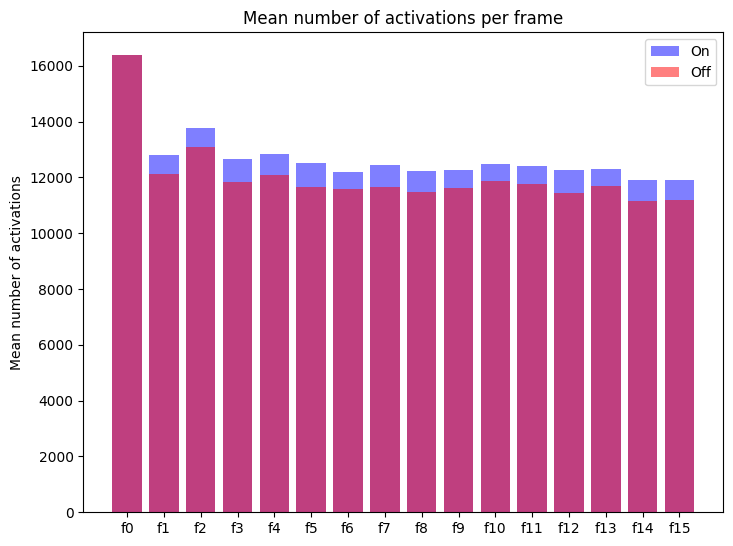

In [153]:
#make a barplot of the mean number of activations
import matplotlib.pyplot as plt
import numpy as np  

fig = plt.figure()
ax = fig.add_axes([0,0,1,1])
frames = ['f0', 'f1', 'f2', 'f3', 'f4', 'f5', 'f6', 'f7', 'f8', 'f9', 'f10', 'f11', 'f12', 'f13', 'f14', 'f15']


ax.bar(frames, mean_number_activations_on,alpha=0.5, color = 'b', label = 'On')
ax.bar(frames, mean_number_activations_off,alpha=0.5, color = 'r', label = 'Off')
ax.set_ylabel('Mean number of activations')
ax.set_title('Mean number of activations per frame')
ax.legend()
plt.show()

In [154]:
import numpy as np

def calculate_mean_activations(videos):
    """
    Calculate the mean activation for each pixel over all frames and channels in multiple videos.
    
    Parameters:
    - videos (list of np.ndarray): List of videos, each video data of shape (frames, height, width, channels).
    
    Returns:
    - np.ndarray: 2D array of mean activations summed across channels.
    """
    # Assuming each video is (frames, height, width, channels)
    # Stack videos to form a large array (total_frames, height, width, channels)
    all_frames = np.concatenate(videos, axis=0)
    
    # Sum across channels to get total activations at each pixel, then compute mean across all frames
    summed_frames = np.sum(all_frames, axis=3)  # Summing activations across channels
    mean_activations = np.mean(summed_frames, axis=0)  # Mean across all frames
    
    return mean_activations


In [168]:
import os
import numpy as np

folder_path = 'pol3.1'
folder_name = 'mix'

# Correctly initializing lists to store total activations per frame across all videos for ON and OFF channels
total_activations_on = [np.zeros((128, 128)) for _ in range(16)]
total_activations_off = [np.zeros((128, 128)) for _ in range(16)]
frame_counts = [0] * 16  # To count the number of frames for averaging

# Iterating over files in the specified folder
for file_name in os.listdir(os.path.join(folder_path, folder_name)):
    if file_name.endswith('.npz'):
        npz_path = os.path.join(folder_path, folder_name, file_name)
        data = np.load(npz_path)
        video = data['arr_0']  # Load the video data

        # Process each frame in the video
        for frame_index in range(video.shape[0]):
            # Sum activations for ON (0) and OFF (1) channels separately
            total_activations_on[frame_index] += video[frame_index, 0, :, :]
            total_activations_off[frame_index] += video[frame_index, 1, :, :]
            frame_counts[frame_index] += 1

# Calculating mean activations for ON and OFF channels
mean_activations_on = [total_activations_on[i] / frame_counts[i] for i in range(16)]
mean_activations_off = [total_activations_off[i] / frame_counts[i] for i in range(16)]


In [165]:
print(mean_activations_off[0])

[[1. 1. 1. ... 1. 1. 1.]
 [1. 1. 1. ... 1. 1. 1.]
 [1. 1. 1. ... 1. 1. 1.]
 ...
 [1. 1. 1. ... 1. 1. 1.]
 [1. 1. 1. ... 1. 1. 1.]
 [1. 1. 1. ... 1. 1. 1.]]


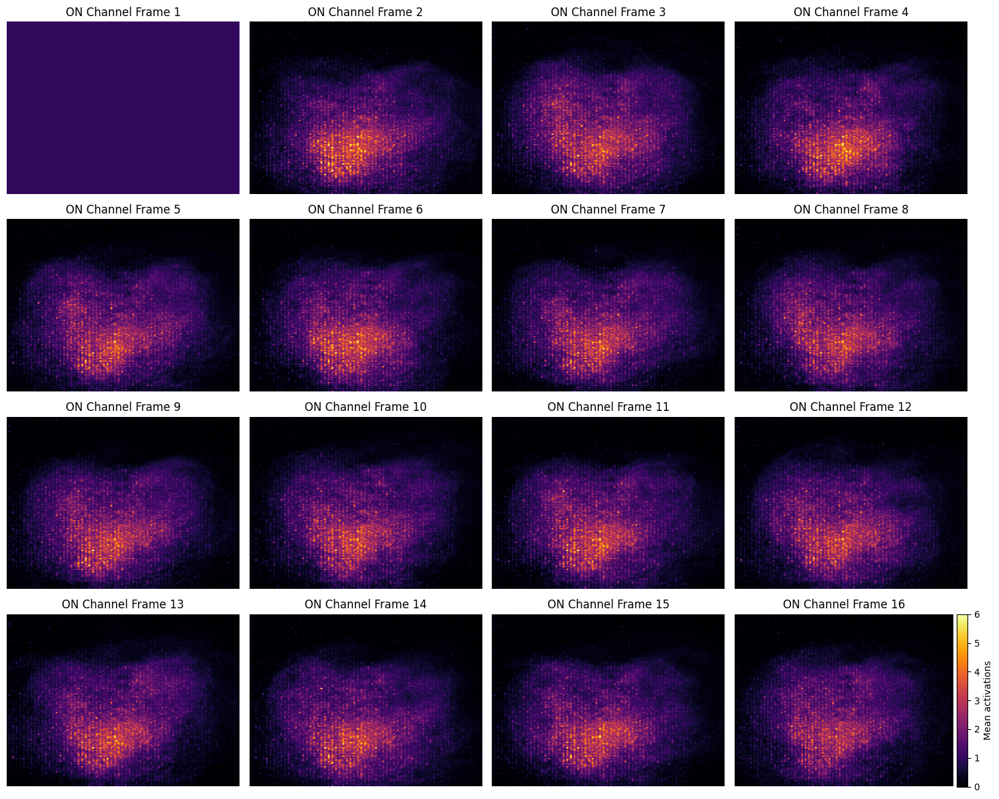

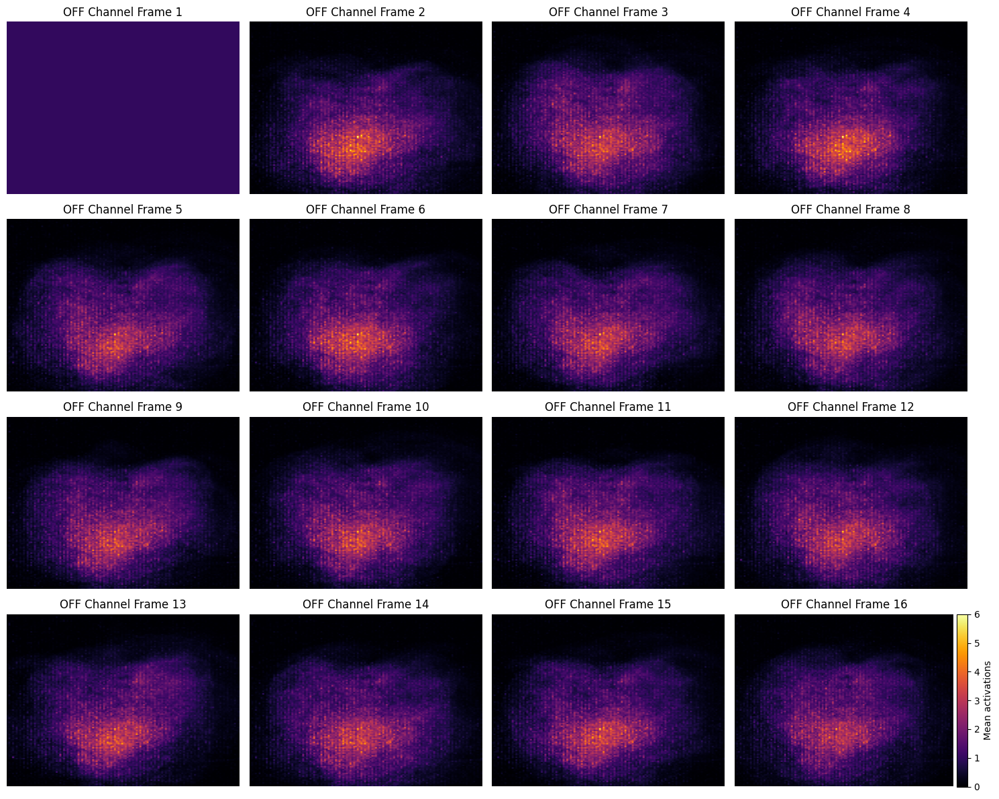

In [160]:
import matplotlib.pyplot as plt

def plot_heatmaps(activations, title_prefix='Mean Activation Heatmap', cmap='inferno'):
    num_frames = len(activations)
    fig, axes = plt.subplots(4, 4, figsize=(15, 12))  # Adjust subplot grid size based on your specific number of frames

    for i, ax in enumerate(axes.flatten()):
        if i < num_frames:
            im = ax.imshow(activations[i], cmap=cmap, aspect='auto',vmax=6,vmin=0)
            ax.set_title(f'{title_prefix} Frame {i+1}')
            ax.axis('off')
        else:
            ax.axis('off')

    # Adjusting the color bar to be outside
    from mpl_toolkits.axes_grid1 import make_axes_locatable
    divider = make_axes_locatable(plt.gca())
    cax = divider.append_axes("right", size="5%", pad=0.05)
    plt.colorbar(im, cax=cax, label='Mean activations')

    plt.tight_layout()
    plt.show()

# Plotting heatmaps for ON and OFF activations
plot_heatmaps(mean_activations_on, title_prefix='ON Channel')
plot_heatmaps(mean_activations_off, title_prefix='OFF Channel')


In [163]:
# Reading all the files from a folder
path_base = 'pol3.1/base'
path_trigger = 'pol3.1/trigger'
base_files = os.listdir(path_base)
trigger_files = os.listdir(path_trigger)

print(f'Found {len(base_files)} base videos and {len(trigger_files)} trigger videos.')

for i in range(min(len(base_files), len(trigger_files))):
    print(f'Comparing video {i+1}/{min(len(base_files), len(trigger_files))}')
    try:
        base = load_video(os.path.join(path_base, f'b_{i}.npz'))
        trigger = load_video(os.path.join(path_trigger, f't_{i}.npz'))
        print('Entropy_base:', calculate_entropy(base))
        print('Entropy_trigger:', calculate_entropy(trigger))
        print('MSE:', calculate_mse(base, trigger))
        print('PSNR:', calculate_psnr(base, trigger))
        print('SSIM:', calculate_ssim(base, trigger))
    except Exception as e:
        print(f'Error processing video {i}: {e}')

Found 117 base videos and 117 trigger videos.
Comparing video 1/117
Error processing video 0: name 'load_video' is not defined
Comparing video 2/117
Error processing video 1: name 'load_video' is not defined
Comparing video 3/117
Error processing video 2: name 'load_video' is not defined
Comparing video 4/117
Error processing video 3: name 'load_video' is not defined
Comparing video 5/117
Error processing video 4: name 'load_video' is not defined
Comparing video 6/117
Error processing video 5: name 'load_video' is not defined
Comparing video 7/117
Error processing video 6: name 'load_video' is not defined
Comparing video 8/117
Error processing video 7: name 'load_video' is not defined
Comparing video 9/117
Error processing video 8: name 'load_video' is not defined
Comparing video 10/117
Error processing video 9: name 'load_video' is not defined
Comparing video 11/117
Error processing video 10: name 'load_video' is not defined
Comparing video 12/117
Error processing video 11: name 'load

In [169]:
from scipy.stats import entropy
import numpy as np

def calculate_entropy_for_frames(activations):
    frame_entropies = []
    for frame in activations:
        # Flatten the frame to calculate histogram
        histogram, _ = np.histogram(frame, bins=256, range=(0, frame.max()+1))
        # Calculate the entropy
        frame_entropy = entropy(histogram)
        frame_entropies.append(frame_entropy)
    return frame_entropies

# Assuming total_activations_on and total_activations_off have been calculated as shown earlier
entropy_on = calculate_entropy_for_frames(total_activations_on)
entropy_off = calculate_entropy_for_frames(total_activations_off)


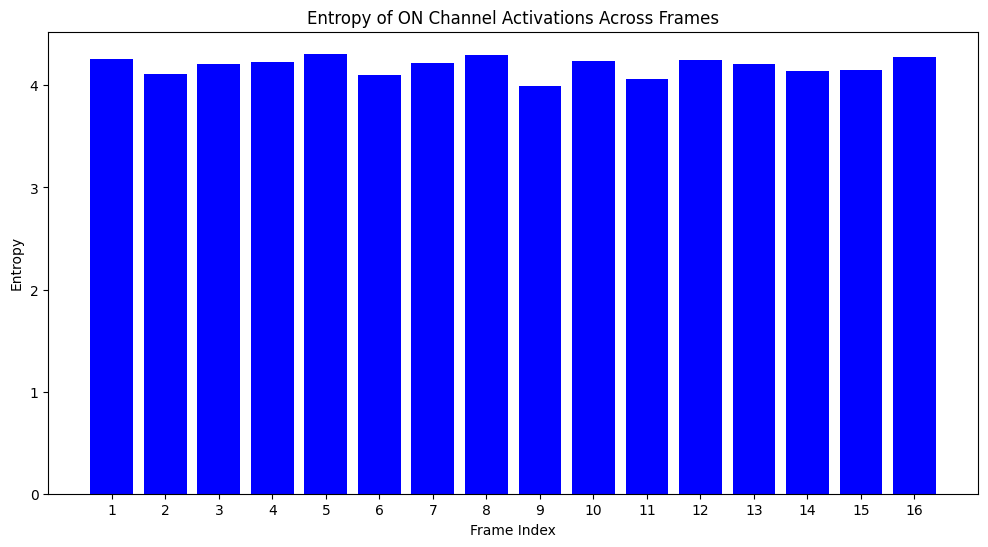

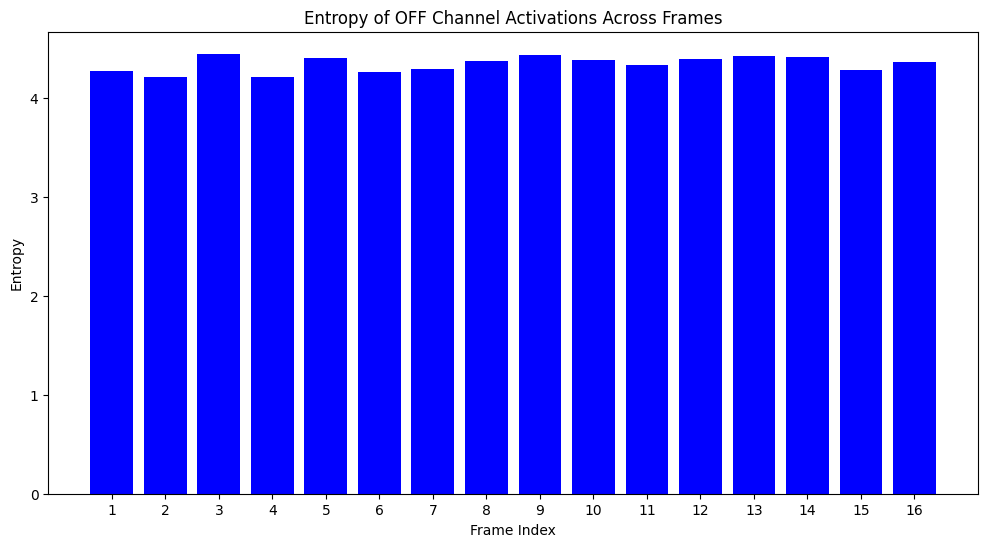

In [170]:
import matplotlib.pyplot as plt

def plot_entropy(entropy_values, title):
    # X positions for each bar
    x = range(1, len(entropy_values) + 1)
    
    plt.figure(figsize=(12, 6))
    plt.bar(x, entropy_values, color='b')
    plt.xlabel('Frame Index')
    plt.ylabel('Entropy')
    plt.title(title)
    plt.xticks(x)  # Set x-ticks to be frame indices
    plt.show()

# Plotting entropy for ON and OFF channel activations
plot_entropy(entropy_on, 'Entropy of ON Channel Activations Across Frames')
plot_entropy(entropy_off, 'Entropy of OFF Channel Activations Across Frames')
